In [1]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
# Root directory for dataset
dataroot = "../yumisepo/images/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 24

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 300

# Learning rate for optimizers
lr = 0.00002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

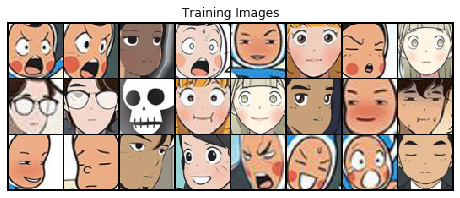

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/300][0/66]	Loss_D: 1.5934	Loss_G: 0.9764	D(x): 0.6657	D(G(z)): 0.6038 / 0.4382
[0/300][50/66]	Loss_D: 0.6267	Loss_G: 2.3665	D(x): 0.8122	D(G(z)): 0.1982 / 0.1368
[1/300][0/66]	Loss_D: 0.3867	Loss_G: 2.7058	D(x): 0.8507	D(G(z)): 0.1268 / 0.0880
[1/300][50/66]	Loss_D: 0.5751	Loss_G: 2.7817	D(x): 0.7762	D(G(z)): 0.1182 / 0.0890
[2/300][0/66]	Loss_D: 0.1807	Loss_G: 3.1172	D(x): 0.9311	D(G(z)): 0.0944 / 0.0628
[2/300][50/66]	Loss_D: 0.1790	Loss_G: 3.2965	D(x): 0.9408	D(G(z)): 0.1019 / 0.0554
[3/300][0/66]	Loss_D: 0.2196	Loss_G: 3.3093	D(x): 0.9122	D(G(z)): 0.1078 / 0.0591
[3/300][50/66]	Loss_D: 0.1202	Loss_G: 3.6011	D(x): 0.9589	D(G(z)): 0.0696 / 0.0373
[4/300][0/66]	Loss_D: 0.1141	Loss_G: 3.8734	D(x): 0.9456	D(G(z)): 0.0461 / 0.0250
[4/300][50/66]	Loss_D: 0.1045	Loss_G: 3.9126	D(x): 0.9727	D(G(z)): 0.0706 / 0.0275
[5/300][0/66]	Loss_D: 0.0842	Loss_G: 4.1556	D(x): 0.9645	D(G(z)): 0.0434 / 0.0216
[5/300][50/66]	Loss_D: 0.1785	Loss_G: 4.6655	D(x): 0.9444	D(G(z)): 

[49/300][50/66]	Loss_D: 0.0080	Loss_G: 6.5941	D(x): 0.9975	D(G(z)): 0.0055 / 0.0014
[50/300][0/66]	Loss_D: 0.0111	Loss_G: 6.5406	D(x): 0.9934	D(G(z)): 0.0044 / 0.0015
[50/300][50/66]	Loss_D: 0.0072	Loss_G: 6.5327	D(x): 0.9981	D(G(z)): 0.0053 / 0.0016
[51/300][0/66]	Loss_D: 0.0097	Loss_G: 6.5932	D(x): 0.9935	D(G(z)): 0.0030 / 0.0015
[51/300][50/66]	Loss_D: 0.0189	Loss_G: 5.7554	D(x): 0.9849	D(G(z)): 0.0025 / 0.0035
[52/300][0/66]	Loss_D: 0.0073	Loss_G: 6.7029	D(x): 0.9969	D(G(z)): 0.0041 / 0.0013
[52/300][50/66]	Loss_D: 0.0081	Loss_G: 7.8803	D(x): 0.9926	D(G(z)): 0.0005 / 0.0004
[53/300][0/66]	Loss_D: 0.0051	Loss_G: 6.3082	D(x): 0.9998	D(G(z)): 0.0049 / 0.0020
[53/300][50/66]	Loss_D: 0.0031	Loss_G: 6.5864	D(x): 0.9998	D(G(z)): 0.0029 / 0.0015
[54/300][0/66]	Loss_D: 0.0172	Loss_G: 6.0970	D(x): 0.9912	D(G(z)): 0.0082 / 0.0026
[54/300][50/66]	Loss_D: 0.0061	Loss_G: 6.6196	D(x): 0.9966	D(G(z)): 0.0027 / 0.0014
[55/300][0/66]	Loss_D: 0.0046	Loss_G: 6.7818	D(x): 0.9987	D(G(z)): 0.0032 / 0.001

[99/300][0/66]	Loss_D: 0.0644	Loss_G: 11.4577	D(x): 0.9411	D(G(z)): 0.0004 / 0.0000
[99/300][50/66]	Loss_D: 0.0324	Loss_G: 5.8597	D(x): 0.9892	D(G(z)): 0.0194 / 0.0052
[100/300][0/66]	Loss_D: 0.0342	Loss_G: 4.9360	D(x): 0.9988	D(G(z)): 0.0314 / 0.0130
[100/300][50/66]	Loss_D: 0.0681	Loss_G: 6.7018	D(x): 0.9394	D(G(z)): 0.0016 / 0.0023
[101/300][0/66]	Loss_D: 0.0505	Loss_G: 4.7187	D(x): 0.9704	D(G(z)): 0.0115 / 0.0122
[101/300][50/66]	Loss_D: 0.0487	Loss_G: 5.0853	D(x): 0.9837	D(G(z)): 0.0306 / 0.0105
[102/300][0/66]	Loss_D: 0.0365	Loss_G: 4.7592	D(x): 0.9976	D(G(z)): 0.0316 / 0.0200
[102/300][50/66]	Loss_D: 0.0707	Loss_G: 13.2404	D(x): 0.9392	D(G(z)): 0.0002 / 0.0001
[103/300][0/66]	Loss_D: 0.0775	Loss_G: 6.3363	D(x): 0.9939	D(G(z)): 0.0655 / 0.0037
[103/300][50/66]	Loss_D: 0.0063	Loss_G: 6.3497	D(x): 0.9965	D(G(z)): 0.0028 / 0.0028
[104/300][0/66]	Loss_D: 0.0259	Loss_G: 5.9199	D(x): 0.9968	D(G(z)): 0.0206 / 0.0074
[104/300][50/66]	Loss_D: 0.1328	Loss_G: 3.0991	D(x): 0.9078	D(G(z)): 0.

[147/300][50/66]	Loss_D: 0.0159	Loss_G: 6.5786	D(x): 0.9870	D(G(z)): 0.0025 / 0.0027
[148/300][0/66]	Loss_D: 0.0566	Loss_G: 4.8382	D(x): 0.9991	D(G(z)): 0.0508 / 0.0133
[148/300][50/66]	Loss_D: 0.0142	Loss_G: 5.8973	D(x): 0.9945	D(G(z)): 0.0086 / 0.0047
[149/300][0/66]	Loss_D: 0.0313	Loss_G: 4.6096	D(x): 0.9990	D(G(z)): 0.0294 / 0.0145
[149/300][50/66]	Loss_D: 0.0691	Loss_G: 5.1530	D(x): 0.9980	D(G(z)): 0.0495 / 0.0146
[150/300][0/66]	Loss_D: 0.0149	Loss_G: 5.3204	D(x): 0.9973	D(G(z)): 0.0121 / 0.0073
[150/300][50/66]	Loss_D: 0.0142	Loss_G: 6.2621	D(x): 0.9913	D(G(z)): 0.0053 / 0.0032
[151/300][0/66]	Loss_D: 0.0057	Loss_G: 6.8490	D(x): 0.9970	D(G(z)): 0.0027 / 0.0018
[151/300][50/66]	Loss_D: 0.1091	Loss_G: 4.3152	D(x): 0.9291	D(G(z)): 0.0150 / 0.0232
[152/300][0/66]	Loss_D: 0.0172	Loss_G: 7.4767	D(x): 0.9843	D(G(z)): 0.0011 / 0.0013
[152/300][50/66]	Loss_D: 0.0334	Loss_G: 5.2518	D(x): 0.9987	D(G(z)): 0.0298 / 0.0123
[153/300][0/66]	Loss_D: 0.0239	Loss_G: 5.0156	D(x): 0.9956	D(G(z)): 0.

[196/300][0/66]	Loss_D: 0.0081	Loss_G: 7.4700	D(x): 0.9938	D(G(z)): 0.0019 / 0.0019
[196/300][50/66]	Loss_D: 0.0602	Loss_G: 6.3103	D(x): 0.9945	D(G(z)): 0.0416 / 0.0040
[197/300][0/66]	Loss_D: 0.0195	Loss_G: 4.7832	D(x): 0.9975	D(G(z)): 0.0167 / 0.0117
[197/300][50/66]	Loss_D: 0.0229	Loss_G: 5.8879	D(x): 0.9836	D(G(z)): 0.0044 / 0.0058
[198/300][0/66]	Loss_D: 0.0262	Loss_G: 5.1510	D(x): 0.9886	D(G(z)): 0.0142 / 0.0141
[198/300][50/66]	Loss_D: 0.0111	Loss_G: 5.7826	D(x): 0.9979	D(G(z)): 0.0090 / 0.0051
[199/300][0/66]	Loss_D: 0.0044	Loss_G: 6.3817	D(x): 0.9992	D(G(z)): 0.0036 / 0.0031
[199/300][50/66]	Loss_D: 0.0160	Loss_G: 5.9387	D(x): 0.9949	D(G(z)): 0.0107 / 0.0062
[200/300][0/66]	Loss_D: 0.0061	Loss_G: 6.7018	D(x): 0.9963	D(G(z)): 0.0023 / 0.0022
[200/300][50/66]	Loss_D: 0.0325	Loss_G: 5.3194	D(x): 0.9861	D(G(z)): 0.0179 / 0.0072
[201/300][0/66]	Loss_D: 0.0134	Loss_G: 6.8749	D(x): 0.9891	D(G(z)): 0.0024 / 0.0016
[201/300][50/66]	Loss_D: 0.0222	Loss_G: 5.8733	D(x): 0.9898	D(G(z)): 0.

[244/300][50/66]	Loss_D: 0.0069	Loss_G: 6.0692	D(x): 0.9989	D(G(z)): 0.0057 / 0.0043
[245/300][0/66]	Loss_D: 0.2112	Loss_G: 7.7064	D(x): 0.9998	D(G(z)): 0.1400 / 0.0015
[245/300][50/66]	Loss_D: 0.0143	Loss_G: 5.1538	D(x): 0.9957	D(G(z)): 0.0100 / 0.0094
[246/300][0/66]	Loss_D: 0.0452	Loss_G: 5.5022	D(x): 0.9928	D(G(z)): 0.0360 / 0.0076
[246/300][50/66]	Loss_D: 0.0249	Loss_G: 6.2394	D(x): 0.9803	D(G(z)): 0.0035 / 0.0032
[247/300][0/66]	Loss_D: 0.0165	Loss_G: 5.5037	D(x): 0.9962	D(G(z)): 0.0125 / 0.0073
[247/300][50/66]	Loss_D: 0.0099	Loss_G: 6.7886	D(x): 0.9933	D(G(z)): 0.0031 / 0.0025
[248/300][0/66]	Loss_D: 0.0043	Loss_G: 7.0558	D(x): 0.9990	D(G(z)): 0.0033 / 0.0016
[248/300][50/66]	Loss_D: 0.0182	Loss_G: 6.1582	D(x): 0.9862	D(G(z)): 0.0039 / 0.0048
[249/300][0/66]	Loss_D: 0.0105	Loss_G: 6.6090	D(x): 0.9920	D(G(z)): 0.0024 / 0.0026
[249/300][50/66]	Loss_D: 0.0112	Loss_G: 5.6219	D(x): 0.9990	D(G(z)): 0.0100 / 0.0066
[250/300][0/66]	Loss_D: 0.0158	Loss_G: 5.4268	D(x): 0.9986	D(G(z)): 0.

[293/300][0/66]	Loss_D: 0.0302	Loss_G: 6.3656	D(x): 0.9751	D(G(z)): 0.0042 / 0.0054
[293/300][50/66]	Loss_D: 0.0078	Loss_G: 7.1848	D(x): 0.9957	D(G(z)): 0.0034 / 0.0026
[294/300][0/66]	Loss_D: 0.0116	Loss_G: 6.3264	D(x): 0.9911	D(G(z)): 0.0025 / 0.0032
[294/300][50/66]	Loss_D: 0.0125	Loss_G: 5.9683	D(x): 0.9963	D(G(z)): 0.0085 / 0.0065
[295/300][0/66]	Loss_D: 0.2679	Loss_G: 8.3640	D(x): 1.0000	D(G(z)): 0.1518 / 0.0006
[295/300][50/66]	Loss_D: 0.0151	Loss_G: 7.1968	D(x): 0.9896	D(G(z)): 0.0045 / 0.0018
[296/300][0/66]	Loss_D: 0.0081	Loss_G: 6.0925	D(x): 0.9992	D(G(z)): 0.0072 / 0.0039
[296/300][50/66]	Loss_D: 0.0322	Loss_G: 6.2976	D(x): 0.9782	D(G(z)): 0.0080 / 0.0097
[297/300][0/66]	Loss_D: 0.0286	Loss_G: 5.6781	D(x): 0.9820	D(G(z)): 0.0098 / 0.0084
[297/300][50/66]	Loss_D: 0.0164	Loss_G: 7.2726	D(x): 0.9859	D(G(z)): 0.0017 / 0.0021
[298/300][0/66]	Loss_D: 0.0168	Loss_G: 6.3068	D(x): 0.9970	D(G(z)): 0.0134 / 0.0061
[298/300][50/66]	Loss_D: 0.0217	Loss_G: 7.1162	D(x): 0.9836	D(G(z)): 0.

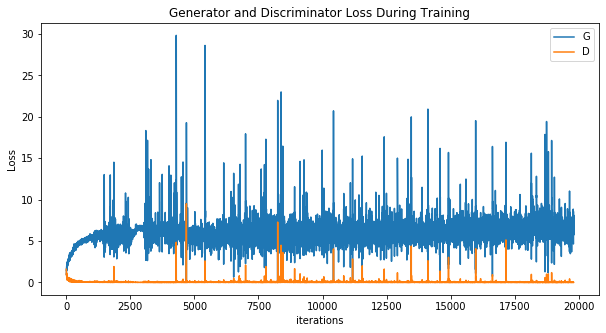

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21489713 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


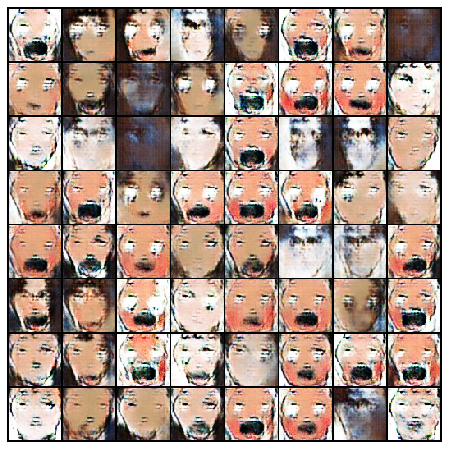

In [12]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

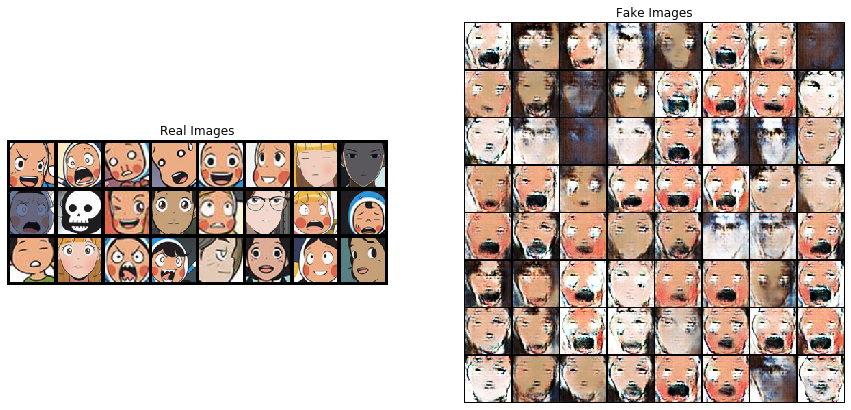

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()